<a href="https://colab.research.google.com/github/KrankVegan/AlzheimerDatabase/blob/main/TESTING_alzheimer_predict.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Proyecto de Clasificación: Predicción de Alzheimer
##INTRUCCIÓN A LA INTELIGENCIA ARTIFICIAL
**Estudiante: Miguel A Martinez C**

En este proyecto se plantea utilizar la base de datos https://www.kaggle.com/datasets/rabieelkharoua/alzheimers-disease-dataset y a partir de ella aplicar lo visto en las clases de machine learning para la creación de un modelo que pueda predecir el diagnóstico de la enfermedad de Alzheimer

#Importando Base de datos

In [1]:
from google.colab import files
import pandas as pd
import numpy as np
from google.colab import autoviz
import seaborn as sns

In [2]:
#Importacion de Librerias necesitadas
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.model_selection import train_test_split, cross_val_score, learning_curve
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_auc_score, roc_curve

In [3]:
!git clone https://github.com/KrankVegan/AlzheimerDatabase.git

fatal: destination path 'AlzheimerDatabase' already exists and is not an empty directory.


In [4]:
path = "/content/AlzheimerDatabase/alzheimers_disease_data.csv"
Alzh_dataset = pd.read_csv(path)
Alzh_dataset.head(15)

,PatientID,Age,Gender,Ethnicity,EducationLevel,BMI,Smoking,AlcoholConsumption,PhysicalActivity,DietQuality,...,MemoryComplaints,BehavioralProblems,ADL,Confusion,Disorientation,PersonalityChanges,DifficultyCompletingTasks,Forgetfulness,Diagnosis,DoctorInCharge
0,4751,73,0,0,2,22.927749,0,13.297218,6.327112,1.347214,...,0,0,1.725883,0,0,0,1,0,0,XXXConfid
1,4752,89,0,0,0,26.827681,0,4.542524,7.619885,0.518767,...,0,0,2.592424,0,0,0,0,1,0,XXXConfid
2,4753,73,0,3,1,17.795882,0,19.555085,7.844988,1.826335,...,0,0,7.119548,0,1,0,1,0,0,XXXConfid
3,4754,74,1,0,1,33.800817,1,12.209266,8.428001,7.435604,...,0,1,6.481226,0,0,0,0,0,0,XXXConfid
4,4755,89,0,0,0,20.716974,0,18.454356,6.310461,0.795498,...,0,0,0.014691,0,0,1,1,0,0,XXXConfid
5,4756,86,1,1,1,30.626886,0,4.140144,0.211062,1.584922,...,0,0,9.015686,1,0,0,0,0,0,XXXConfid
6,4757,68,0,3,2,38.387622,1,0.646047,9.257695,5.897388,...,0,0,9.236328,0,0,0,0,1,0,XXXConfid
7,4758,75,0,0,1,18.776009,0,13.723826,4.649451,8.341903,...,0,0,4.517248,1,0,0,0,1,1,XXXConfid
8,4759,72,1,1,0,27.833188,0,12.167848,1.531360,6.736882,...,0,1,0.756232,0,0,1,0,0,0,XXXConfid
9,4760,87,0,0,0,35.456302,1,16.028688,6.440773,8.086019,...,0,1,4.554394,0,0,0,0,0,0,XXXConfid


In [5]:
Alzh_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2149 entries, 0 to 2148
Data columns (total 35 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   PatientID                  2149 non-null   int64  
 1   Age                        2149 non-null   int64  
 2   Gender                     2149 non-null   int64  
 3   Ethnicity                  2149 non-null   int64  
 4   EducationLevel             2149 non-null   int64  
 5   BMI                        2149 non-null   float64
 6   Smoking                    2149 non-null   int64  
 7   AlcoholConsumption         2149 non-null   float64
 8   PhysicalActivity           2149 non-null   float64
 9   DietQuality                2149 non-null   float64
 10  SleepQuality               2149 non-null   float64
 11  FamilyHistoryAlzheimers    2149 non-null   int64  
 12  CardiovascularDisease      2149 non-null   int64  
 13  Diabetes                   2149 non-null   int64

#Analisis Preliminar y Preprocesamiento

Utilizamos la matriz de correlación para ver las variables más correlacionadas con nuestro variable objetivo (Diagnosis de Alzheimer)

In [6]:
# Calcular la matriz de correlación
df = Alzh_dataset.dropna()
df = df.drop(columns=['DoctorInCharge'])
correMatrix = df
corr_matrix = correMatrix.corr()

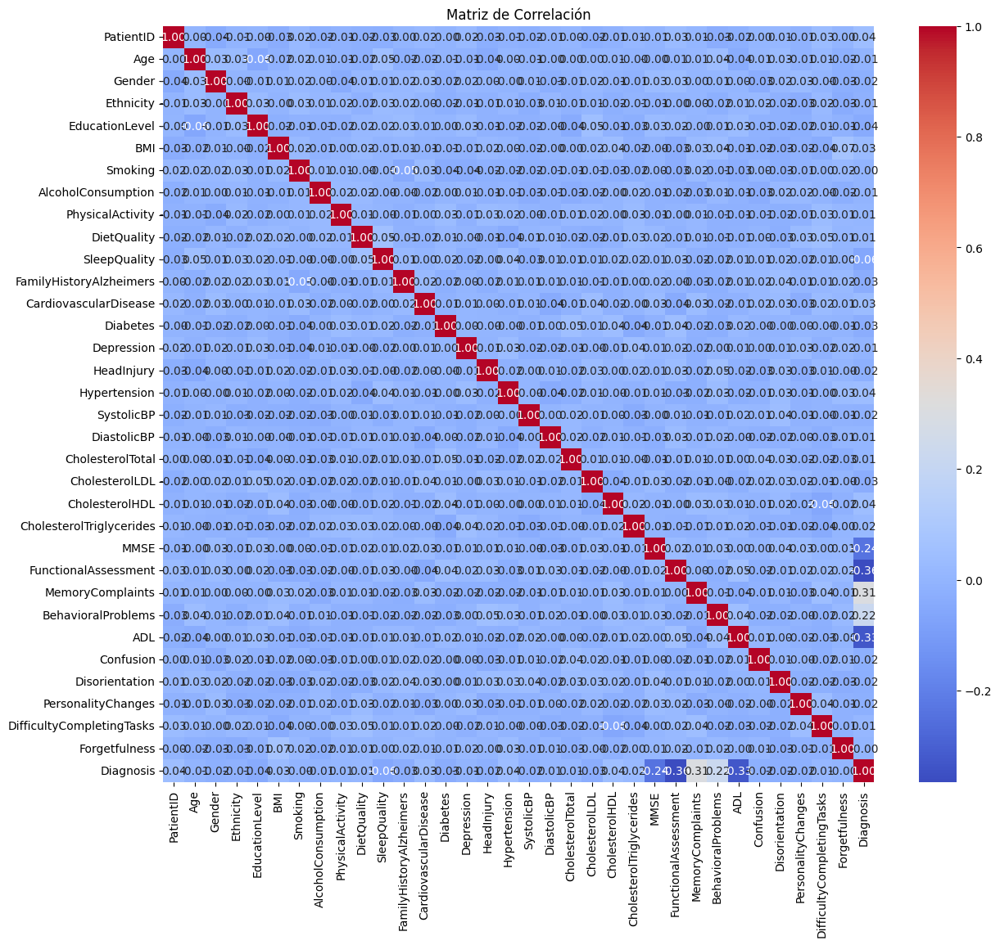

In [7]:
import seaborn as sns
import matplotlib.pyplot as plt

# Crear el mapa de calor de la matriz de correlación
plt.figure(figsize=(14, 12))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm')

# Configurar el título
plt.title('Matriz de Correlación')
plt.show()

Al observar la matriz se puede observar que las variables mas correlacionadas son 'ADL', 'MMSE', 'FunctionalAssessment','MemoryComplaints','BehavioralProblems'. Con lo cual utilizamos estas para el entrenamiento

In [8]:
# Preprocesamiento
columns = ['ADL', 'MMSE', 'FunctionalAssessment','MemoryComplaints','BehavioralProblems'] #Columnas mas correlacionadas con la variable objetivo

#Normalizacion

Otros modelos para evaluar la base de datos:

In [9]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

In [10]:
#Normalizacion de las columnas
min_max_scaler = MinMaxScaler()
df[columns] = min_max_scaler.fit_transform(df[columns])

In [11]:
df[columns].head(10)

,ADL,MMSE,FunctionalAssessment,MemoryComplaints,BehavioralProblems
0,0.172486,0.715606,0.652102,0.0,0.0
1,0.259154,0.687251,0.712108,0.0,0.0
2,0.711936,0.245145,0.589697,0.0,0.0
3,0.648094,0.466410,0.896823,0.0,1.0
4,0.001341,0.450619,0.604699,0.0,0.0
5,0.901579,0.917500,0.551189,0.0,0.0
6,0.923646,0.065334,0.606409,0.0,0.0
7,0.451666,0.337965,0.340227,0.0,0.0
8,0.075506,0.860914,0.739856,0.0,1.0
9,0.455381,0.946543,0.114890,0.0,1.0


In [12]:
y = df['Diagnosis'] #Variable Objetivo
X = df[columns]# variables de entrenamiento anteriores

In [13]:
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Modelos

In [14]:
# Define the models
models = {
    "Logistic Regression": LogisticRegression(random_state=42),
    "k-Nearest Neighbors": KNeighborsClassifier(),
    "Naive Bayes": GaussianNB(),
    "Decision Tree": DecisionTreeClassifier(random_state=42),
    "Random Forest": RandomForestClassifier(random_state=42)
}

# Train and evaluate each model
model_results = {}

for name, model in models.items():
    model.fit(X_train, y_train)  # Train the model
    y_pred = model.predict(X_test)  # Make predictions
    accuracy = accuracy_score(y_test, y_pred)  # Evaluate accuracy
    model_results[name] = accuracy  # Store the results
    print(f"{name}: Accuracy = {accuracy:.2f}")

Logistic Regression: Accuracy = 0.83
k-Nearest Neighbors: Accuracy = 0.92
Naive Bayes: Accuracy = 0.82
Decision Tree: Accuracy = 0.90
Random Forest: Accuracy = 0.95


Ahora procedemos a elegir los 3 modelos que mejor accuracy nos dieron y evaluar su: Decision Tree, Random Forest y k-Nearest Neighbor

#Evaluación del rendimiento y Analisis

##Random Forest


In [15]:
# Seleccionar y entrenar el modelo
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Realizar predicciones y evaluar el modelo
y_pred = model.predict(X_test)

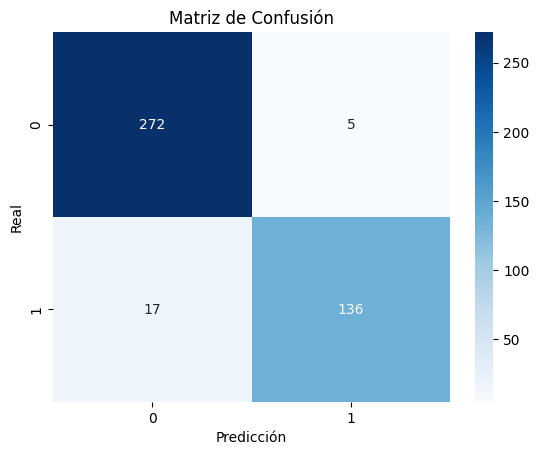

In [16]:
# Matriz de Confusión
conf_matrix = confusion_matrix(y_test, y_pred)
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Matriz de Confusión')
plt.xlabel('Predicción')
plt.ylabel('Real')
plt.show()

In [17]:
# Reporte de clasificación
print("Reporte de clasificación:")
print(classification_report(y_test, y_pred))

Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96       277
           1       0.96      0.89      0.93       153

    accuracy                           0.95       430
   macro avg       0.95      0.94      0.94       430
weighted avg       0.95      0.95      0.95       430



CHECK FOR OVERFITTING a.k.a Checkear para sobreajuste

Train Accuracy: 1.00
Test Accuracy: 0.95
Cross-Validation Scores: [0.98604651 0.98604651 0.96744186 0.99302326 0.81351981]
Cross-Validation Mean: 0.95


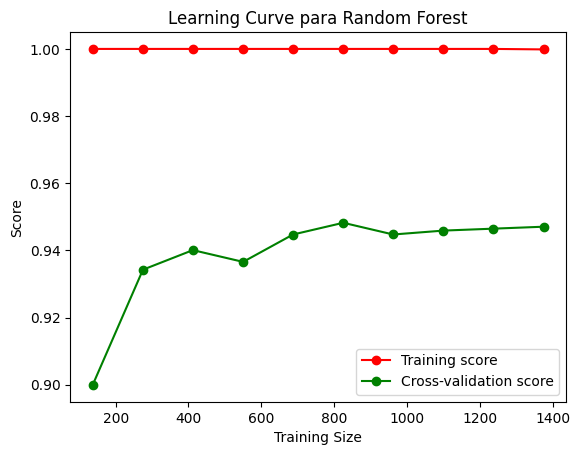

In [18]:
# Check for overfitting using accuracy
train_accuracy = accuracy_score(y_train, model.predict(X_train))
test_accuracy = accuracy_score(y_test, model.predict(X_test))
print(f'Train Accuracy: {train_accuracy:.2f}')
print(f'Test Accuracy: {test_accuracy:.2f}')

# Cross-validation to check for overfitting
cross_val_scores = cross_val_score(model, X, y, cv=5)
print(f'Cross-Validation Scores: {cross_val_scores}')
print(f'Cross-Validation Mean: {cross_val_scores.mean():.2f}')

# Learning curve o curva de aprendizaje
train_sizes, train_scores, test_scores = learning_curve(model, X_train, y_train, cv=5, scoring='accuracy',
                                                        train_sizes=np.linspace(0.1, 1.0, 10))

train_scores_mean = train_scores.mean(axis=1)
test_scores_mean = test_scores.mean(axis=1)

plt.figure()
plt.plot(train_sizes, train_scores_mean, 'o-', color='r', label='Training score')
plt.plot(train_sizes, test_scores_mean, 'o-', color='g', label='Cross-validation score')
plt.xlabel('Training Size')
plt.ylabel('Score')
plt.title('Learning Curve para Random Forest')
plt.legend(loc='best')
plt.show()

##DecisionTree


In [19]:
# Seleccionar y entrenar el modelo
model = DecisionTreeClassifier(random_state=42)
model.fit(X_train, y_train)

# Realizar predicciones y evaluar el modelo
y_pred = model.predict(X_test)

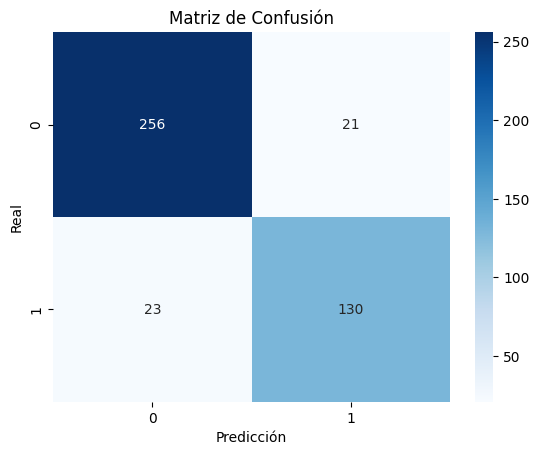

In [20]:
# Matriz de Confusión
conf_matrix = confusion_matrix(y_test, y_pred)
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Matriz de Confusión')
plt.xlabel('Predicción')
plt.ylabel('Real')
plt.show()

In [21]:
# Reporte de clasificación
print("Reporte de clasificación:")
print(classification_report(y_test, y_pred))

Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.92      0.92      0.92       277
           1       0.86      0.85      0.86       153

    accuracy                           0.90       430
   macro avg       0.89      0.89      0.89       430
weighted avg       0.90      0.90      0.90       430



CHECK FOR OVERFITTING a.k.a Checkear para sobreajuste

Train Accuracy: 1.00
Test Accuracy: 0.90
Cross-Validation Scores: [0.93488372 0.93953488 0.89534884 0.95116279 0.80885781]
Cross-Validation Mean: 0.91


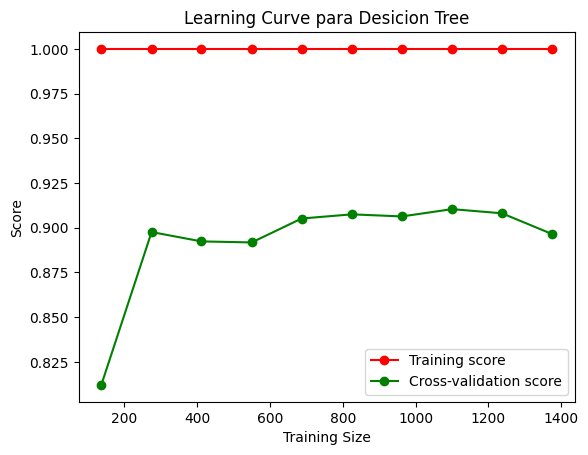

In [22]:
# Check for overfitting using accuracy
train_accuracy = accuracy_score(y_train, model.predict(X_train))
test_accuracy = accuracy_score(y_test, model.predict(X_test))
print(f'Train Accuracy: {train_accuracy:.2f}')
print(f'Test Accuracy: {test_accuracy:.2f}')

# Cross-validation to check for overfitting
cross_val_scores = cross_val_score(model, X, y, cv=5)
print(f'Cross-Validation Scores: {cross_val_scores}')
print(f'Cross-Validation Mean: {cross_val_scores.mean():.2f}')

# Learning curve o curva de aprendizaje
train_sizes, train_scores, test_scores = learning_curve(model, X_train, y_train, cv=5, scoring='accuracy',
                                                        train_sizes=np.linspace(0.1, 1.0, 10))

train_scores_mean = train_scores.mean(axis=1)
test_scores_mean = test_scores.mean(axis=1)

plt.figure()
plt.plot(train_sizes, train_scores_mean, 'o-', color='r', label='Training score')
plt.plot(train_sizes, test_scores_mean, 'o-', color='g', label='Cross-validation score')
plt.xlabel('Training Size')
plt.ylabel('Score')
plt.title('Learning Curve para Desicion Tree')
plt.legend(loc='best')
plt.show()

##k-Nearest Neighbors


In [23]:
# Seleccionar y entrenar el modelo
model = KNeighborsClassifier()
model.fit(X_train, y_train)

# Realizar predicciones y evaluar el modelo
y_pred = model.predict(X_test)

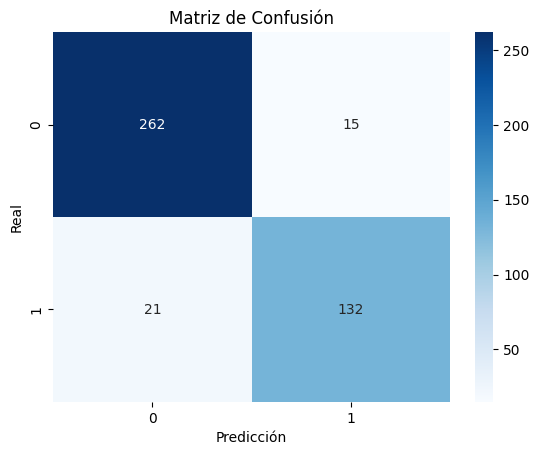

In [24]:
# Matriz de Confusión
conf_matrix = confusion_matrix(y_test, y_pred)
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Matriz de Confusión')
plt.xlabel('Predicción')
plt.ylabel('Real')
plt.show()

In [25]:
# Reporte de clasificación
print("Reporte de clasificación:")
print(classification_report(y_test, y_pred))

Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.93      0.95      0.94       277
           1       0.90      0.86      0.88       153

    accuracy                           0.92       430
   macro avg       0.91      0.90      0.91       430
weighted avg       0.92      0.92      0.92       430



CHECK FOR OVERFITTING a.k.a Checkear para sobreajuste

Train Accuracy: 0.94
Test Accuracy: 0.92
Cross-Validation Scores: [0.94883721 0.95581395 0.93488372 0.95813953 0.78787879]
Cross-Validation Mean: 0.92


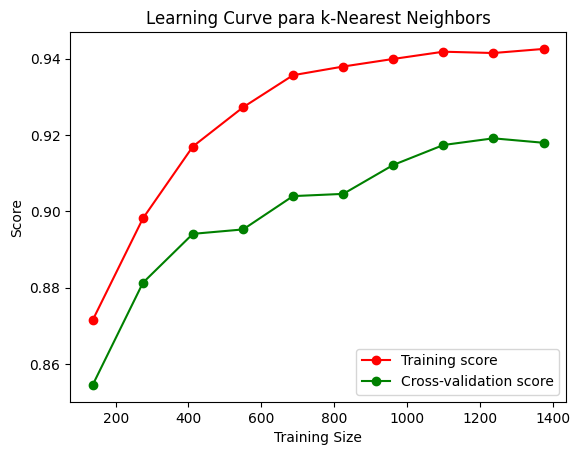

In [26]:
# Check for overfitting using accuracy
train_accuracy = accuracy_score(y_train, model.predict(X_train))
test_accuracy = accuracy_score(y_test, model.predict(X_test))
print(f'Train Accuracy: {train_accuracy:.2f}')
print(f'Test Accuracy: {test_accuracy:.2f}')

# Cross-validation to check for overfitting
cross_val_scores = cross_val_score(model, X, y, cv=5)
print(f'Cross-Validation Scores: {cross_val_scores}')
print(f'Cross-Validation Mean: {cross_val_scores.mean():.2f}')

# Learning curve o curva de aprendizaje
train_sizes, train_scores, test_scores = learning_curve(model, X_train, y_train, cv=5, scoring='accuracy',
                                                        train_sizes=np.linspace(0.1, 1.0, 10))

train_scores_mean = train_scores.mean(axis=1)
test_scores_mean = test_scores.mean(axis=1)

plt.figure()
plt.plot(train_sizes, train_scores_mean, 'o-', color='r', label='Training score')
plt.plot(train_sizes, test_scores_mean, 'o-', color='g', label='Cross-validation score')
plt.xlabel('Training Size')
plt.ylabel('Score')
plt.title('Learning Curve para k-Nearest Neighbors')
plt.legend(loc='best')
plt.show()

**Analisis de curva de aprendizaje**

Al observar las curvas dadas por los tres modelos se puede hacer una conclusión de que Random Forest y Desicion Trees estan produciendo valores y mostrando curvas que indican un sobre ajuste o *overfitting* a pesar de tener un accuracy muy alto. Al mismo tiempo k-Nearest Neighbors muestra una curva de aprendiza y valores de validación cruzada prometedores. Su accuracy es de 0.92.

Con lo cual se concluye que el mejor modelo seria el **k-Nearest Neighbors**

#Reporte tipo Data Profiling

In [27]:
pip install ydata-profiling

In [28]:
from ydata_profiling import ProfileReport

In [29]:
profile = ProfileReport(Alzh_dataset, title="Alzheimer's Disease Data Profiling Report", explorative=True)
profile.to_file("alzheimers_data_profiling_report.html")
profile.to_notebook_iframe()

/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:363: UserWarning: Try running command: 'pip install --upgrade Pillow' to avoid ValueError
  warnings.warn(


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

#Guardar el Modelo

El módulo **pickle** se puede utilizar para serializar y deserializar los objetos de Python. Pickling es el proceso de convertir una jerarquía de objetos Python en un flujo de bytes, mientras que Unpickling es el proceso de convertir un flujo de bytes (desde un archivo binario u otro objeto que parezca estar hecho de bytes) de nuevo a una jerarquía de objetos.

Para guardar los modelos ML utilizados como un archivo pickle, es necesario utilizar el módulo Pickle que ya viene con la instalación por defecto de Python.

Para guardar tu modelo clasificador de iris simplemente tienes que decidir un nombre de archivo y volcar tu modelo a un archivo pickle de la siguiente manera:

In [30]:
import pickle

# save the alzheimer classification model as a pickle file
model_pkl_file = "alzheimer_classifier_model.pkl"

with open(model_pkl_file, 'wb') as file:
    pickle.dump(model, file)

# Referencias

1. [ROC and AUC](https://developers.google.com/machine-learning/crash-course/classification/roc-and-auc). *Google Developers*.

2. [Saving Trained Model in Python](https://neptune.ai/blog/saving-trained-model-in-python). *Neptune Blog*.

3. [Confusion Matrix](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.confusion_matrix.html). *scikit-learn*.

4. [Parameters and Hyperparameters](https://towardsdatascience.com/parameters-and-hyperparameters-aa609601a9ac). *Towards Data Science*.

5. [Explain ROC Curve](https://www.evidentlyai.com/classification-metrics/explain-roc-curve). *Evidently AI*.

6. [Alzheimer's Disease Dataset](https://www.kaggle.com/datasets/rabieelkharoua/alzheimers-disease-dataset). *Kaggle*.

7. [Alzheimer's Disease Prediction Notebook](https://www.kaggle.com/code/adhamtarek147/alzheimer-s-disease-prediction/notebook). *Kaggle*.
